<a href="https://colab.research.google.com/github/Barneybean/profanity_in_lyrics_U.S._billboard/blob/master/profanity_in_lyrics_U_S__billboard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Profanity in Lyrics
### Songs in top 100 U.S. Billboard 1960 to 2020

![alt text](https://www.lyricopera.org/~/media/images/lyricunlimited/lyric_unlimited_simple_black_and_red.png?h=240&&w=500&la=en)
![alt text](http://i.imgur.com/Emx7Oow.jpg)

## Ingest

### Import and Pre-Process Data

In [0]:
#Install lyricsgenius package
# !pip install -q lyricsgenius
# !pip install -q wordcloud
# !pip install -q lyricsgenius
# !pip install -q --upgrade sns

#for plotly
!pip uninstall -q -y plotly
!pip install -q plotly
!pip install -q --upgrade cufflinks

In [94]:
import lyricsgenius
import json
import pandas as pd
import numpy as np
from scipy import stats
import pickle
import time

#visualization
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot;

#word cloud
from PIL import Image
from os import path
import os
import random
import urllib
import requests
from wordcloud import WordCloud, STOPWORDS

#Machine Learning 
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Customized plotly
import plotly.offline as py
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import cufflinks as cf
cf.go_offline()

import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot;



In [0]:
# hot_songs = pd.read_csv('https://query.data.world/s/3jktjhrludnr6o3fhtzafbwbfzq6vg')
hot_songs = pd.read_csv("https://raw.githubusercontent.com/Barneybean/profanity_in_lyrics_U.S._billboard/master/billboard_music.csv")

In [9]:
hot_songs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 315295 entries, 0 to 315294
Data columns (total 10 columns):
url                       315295 non-null object
WeekID                    315295 non-null object
Week Position             315295 non-null int64
Song                      315295 non-null object
Performer                 315295 non-null object
SongID                    315295 non-null object
Instance                  315295 non-null int64
Previous Week Position    285181 non-null float64
Peak Position             315295 non-null int64
Weeks on Chart            315295 non-null int64
dtypes: float64(1), int64(4), object(5)
memory usage: 24.1+ MB


In [10]:
hot_songs.describe()
#max of peak position is 100

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart
count,315295.000000,315295.000000,285181.000000,315295.000000,315295.000000
mean,50.499282,1.062878,47.655997,41.493627,9.031310
std,28.865693,0.292701,28.067912,29.529822,7.399562
min,1.000000,1.000000,1.000000,1.000000,1.000000
25%,25.500000,1.000000,23.000000,14.000000,4.000000
50%,50.000000,1.000000,47.000000,39.000000,7.000000
75%,75.000000,1.000000,72.000000,66.000000,13.000000
max,100.000000,8.000000,100.000000,100.000000,87.000000


In [0]:
hot_songs.rename(columns={"WeekID":"week_ID", 
                          "Week Position":"week_position",
                          "Song":"song",
                          "Performer":"performer",
                          "SongID":"song_ID",
                          "Instance":"instance",
                          "Previous Week Position":"previous_week_position",
                          "Peak Position":"peak_position",
                          "Weeks on Chart":"weeks_on_chart"}, inplace=True)


In [12]:
hot_songs.head(2)

,url,week_ID,week_position,song,performer,song_ID,instance,previous_week_position,peak_position,weeks_on_chart
0,http://www.billboard.com/charts/hot-100/2012-1...,12/15/2012,21,Don't You Worry Child,Swedish House Mafia Featuring John Martin,Don't You Worry ChildSwedish House Mafia Featu...,1,28.0,21,11
1,http://www.billboard.com/charts/hot-100/2012-1...,12/22/2012,14,Don't You Worry Child,Swedish House Mafia Featuring John Martin,Don't You Worry ChildSwedish House Mafia Featu...,1,21.0,14,12


In [13]:
hot_songs.tail(2)

,url,week_ID,week_position,song,performer,song_ID,instance,previous_week_position,peak_position,weeks_on_chart
315293,http://www.billboard.com/charts/hot-100/2013-0...,3/16/2013,83,I Can Take It From There,Chris Young,I Can Take It From ThereChris Young,1,96.0,83,4
315294,http://www.billboard.com/charts/hot-100/2017-0...,4/22/2017,84,No Frauds,"Nicki Minaj, Drake & Lil Wayne","No FraudsNicki Minaj, Drake & Lil Wayne",1,75.0,14,4


## EDA

#### Caculate weighted average on ranking using peak positions anf weeks on chart for that rank 

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.



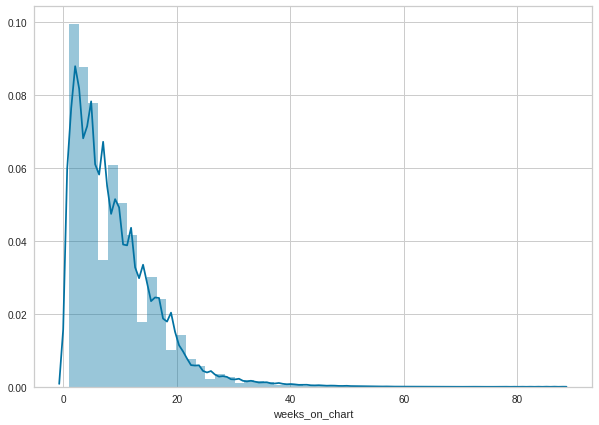

In [14]:
plt.subplots(figsize=(10,7))

sns.distplot(hot_songs["weeks_on_chart"] )

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.



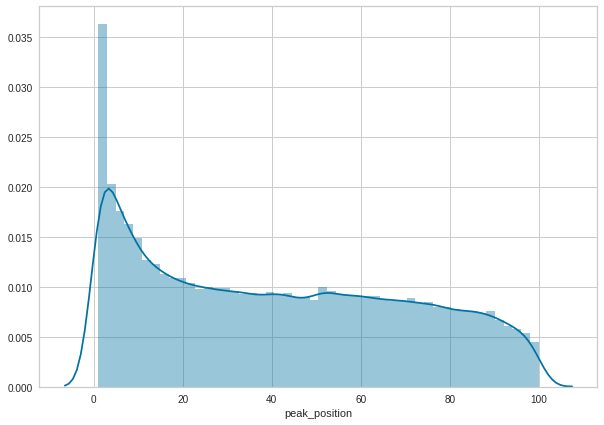

In [15]:
plt.subplots(figsize=(10,7))

sns.distplot(hot_songs["peak_position"] )

In [0]:
hot_songs["year"] = pd.to_datetime(hot_songs["week_ID"]).dt.year

In [0]:
#(100 - peak_position) because the higher rank the smaller number

hot_songs_agg_by_date_song = hot_songs.groupby(['song','year'], as_index=False).agg({
    'week_position':'mean', 
    'instance':'mean',
    'previous_week_position':'mean',
    'peak_position':'mean',
    'weeks_on_chart':'mean'}).rename(columns={
    'week_position':'avg_week_position',
    'instance':'instance',
    'previous_week_position':'avg_previous_week_position',
    'peak_position':'avg_peak_position',
    'weeks_on_chart':'avg_weeks_on_chart'})



In [18]:
print(len(hot_songs_agg_by_date_song))
hot_songs_agg_by_date_song.head()


33392


,song,year,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart
0,"""B"" Girls",1990,71.000000,1.0,69.571429,59.266667,8.0
1,"""Cherry Cherry"" from Hot August Night",1973,47.900000,1.0,47.555556,45.900000,5.5
2,"""Having A Party"" Medley",1973,76.000000,1.0,77.750000,75.333333,5.0
3,"""Joy"" Pt. I",1973,67.000000,1.0,72.000000,67.000000,1.5
4,"""Joy"" Pt. I",1974,35.142857,1.0,38.000000,33.428571,6.0


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.



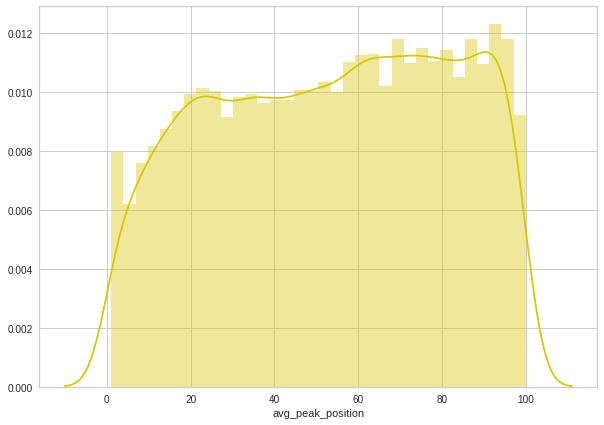

In [19]:
plt.subplots(figsize=(10,7))

sns.distplot(hot_songs_agg_by_date_song["avg_peak_position"], color="y")

### Scraping Lyrics

In [0]:
genius = lyricsgenius.Genius("qABKAzoV-Vp3IfVJVmwDRwU-qwr9r19oYHKNWs3pJwQIy27Kdt7mIJKXVziJZBYW")
genius.verbose = False # Turn off status messages
genius.remove_section_headers = True # Remove section headers (e.g. [Chorus]) from lyrics when searching
genius.skip_non_songs = False # Include hits thought to be non-songs (e.g. track lists)
genius.excluded_terms = ["(Live)"] # Exclude songs with these words in their title

In [0]:
data = hot_songs_agg_by_date_song.sample(n=1000)
# data = hot_songs_agg_by_date_song

data1 = data[:100]
data2 = data[100:200]
data3 = data[200:300]
data4 = data[300:400]
data5 = data[400:500]
data6 = data[500:600]
data7 = data[600:700]
data8 = data[700:800]
data9 = data[800:900]
data10 = data[900:1000]

data_arr = [data1['song'], data2['song'], data3['song'], data4['song'], data5['song'], data6['song'], data7['song'], data8['song'], data9['song'], data10['song']]



In [0]:
#Run a for loop to scrape all lyrics of song titles from the songs list
lyrics_arr = []

for sub in data_arr:   
    for x in sub:
        try:  
            track = genius.search_song(x)
            lyrics_arr.append(track.lyrics)
        except:
            lyrics_arr.append("na")
    time.sleep(10)

Timeout raised and caught:
HTTPSConnectionPool(host='api.genius.com', port=443): Read timed out. (read timeout=5)
Timeout raised and caught:
HTTPSConnectionPool(host='api.genius.com', port=443): Read timed out. (read timeout=5)


In [0]:
len(lyrics_arr)

***Process Scraped Data***

In [0]:
data["lyric"] = lyrics_arr

In [22]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [55]:
# pickle.dump(data, open('song_lyrics.pickle', 'wb'))
# !ls -l song_lyrics.pickle
#!cat mydictionary.pickle
data = pickle.load(open('/content/gdrive/My Drive/Colab Notebooks/Final Project/song_lyrics.pickle', "rb"))
# data = pickle.load(open(uploaded, "rb"))
print(data.shape)
data.tail()


(1000, 8)


,song,year,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart,lyric
20079,Nothin' Better To Do,2007,83.083333,1.0,82.909091,80.333333,6.5,"I love all your shit talkin', I love all your ..."
18838,Motivation,2011,27.440000,1.0,26.750000,23.240000,13.0,"Go, go, go, go (Turn the lights off) Oh lover..."
32883,You Ought To Be With Me,1973,29.500000,1.0,18.250000,3.000000,13.5,Sit right down and talk to me About how you wa...
28213,The Tide Is High,1980,35.428571,1.0,40.000000,35.428571,4.0,"Uh uh uh, yeah, V's up motherfucker what it is..."
6487,Don't Cha,2006,35.800000,1.0,36.600000,2.000000,38.0,"Okay (Ahh) Yeah (Ahh) Oh, we about to get it j..."


In [0]:
data["lyric"] = data["lyric"].apply(lambda x: x.replace("\n", " "))

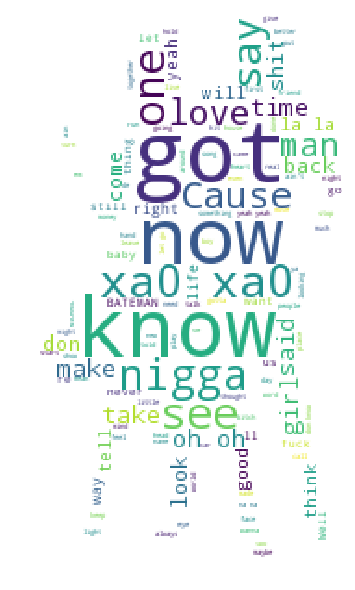

In [57]:
from PIL import Image
import urllib
import requests

words = str(data["lyric"].values)
mask = np.array(Image.open(requests.get('http://www.clker.com/cliparts/a/7/7/c/11954223851908082850Gerald_G_Fifties_Dancers_1.svg.med.png', stream=True).raw))

# This function takes in your text and your mask and generates a wordcloud. 
def generate_wordcloud(words, mask):
    word_cloud = WordCloud(width = 512, height = 512, background_color='white', stopwords=STOPWORDS, mask=mask).generate(words)
    plt.figure(figsize=(10,8),facecolor = 'white', edgecolor='blue')
    plt.imshow(word_cloud)
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()
    
#Run the following to generate your wordcloud
generate_wordcloud(words, mask)


### Count profanity world 

In [58]:
words = pd.read_csv("https://raw.githubusercontent.com/Barneybean/profanity_in_lyrics_U.S._billboard/master/p_words.csv")
profanity_words = list(words['profanity_word'])
print(len(profanity_words))
profanity_words[:10]


448


['4r5e', '5h1t', '5hit', 'a55', 'anal', 'anus', 'ar5e', 'arrse', 'arse', 'ass']

In [0]:
# count occurrence of profanity words in each song
def count_p_word(lyric):
    count = 0
    for word in profanity_words: 
        count += lyric.count(word)
    return count

In [0]:
#create a column containing profanity words multiply by occurance
def record_word(lyric):
    prof_words = ''
    for word in profanity_words: 
        count = lyric.count(word)
        for i in range(0, count): 
            prof_words += word + " "
    return prof_words

In [0]:
#total word count of lyrics 
def word_count(lyric):
    words = lyric.split(" ")
    return len(words)

In [0]:
data["count_profanity_word"] = data["lyric"].apply(lambda x: count_p_word(x))

In [0]:
data["profanity_words"] = data["lyric"].apply(lambda x: record_word(x))

In [0]:
data["lyric_word_count"] = data["lyric"].apply(lambda x: word_count(x))

In [0]:
data["profanity_word_ratio"] = round(data["count_profanity_word"]/data["lyric_word_count"], 2)

In [66]:
data.head(2)

,song,year,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart,lyric,count_profanity_word,profanity_words,lyric_word_count,profanity_word_ratio
11577,How To Save A Life,2006,44.333333,1.944444,43.882353,42.361111,18.5,"Step one, you say we need to talk He walks, yo...",0,,389,0.00
2396,Back To The Hotel,1993,32.200000,1.000000,27.400000,15.400000,28.0,Yeah Still callin Show me what I showed you Y...,15,bum fuck fuck fuck fuck fuck fuck fuck fuck ni...,549,0.03


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.



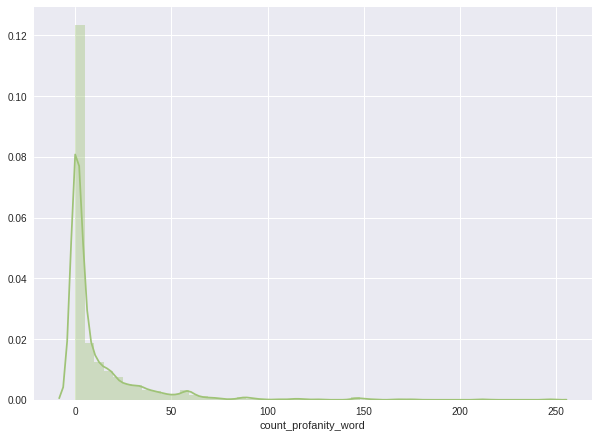

In [67]:
plt.subplots(figsize=(10,7))
sns.distplot(data["count_profanity_word"], color="g")

### Word Cloud Of Profanity Words

In [0]:
stopwords = set(STOPWORDS)
size = (20,15)

def cloud(text, title, stopwords=stopwords, size=size):
    """
    Function to plot WordCloud
    Includes: 
    """
    # Setting figure parameters
    mpl.rcParams['figure.figsize']=(10.0,10.0)
    mpl.rcParams['font.size']=12
    mpl.rcParams['savefig.dpi']=100
    mpl.rcParams['figure.subplot.bottom']=.1 
    
    # Processing Text
    wordcloud = WordCloud(width=1600, height=800,
                          background_color='black',
                          stopwords=stopwords,
                         ).generate(str(text))
    # Output Visualization
    fig = plt.figure(figsize=size, dpi=80, facecolor='k',edgecolor='k')
    plt.imshow(wordcloud,interpolation='bilinear')
    plt.axis('off')
    plt.title(title, fontsize=50,color='Blue')
    plt.tight_layout(pad=0)
    plt.show()

![alt text](http://5b0988e595225.cdn.sohucs.com/images/20181201/b5a83bb65a344c9d81f9530fc430eb69.jpeg)

# OOPS!!

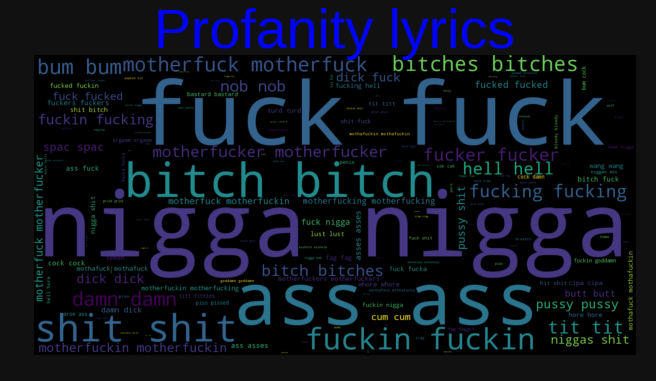

In [69]:
def cloud(text, title, stopwords=stopwords, size=size):
    """
    Function to plot WordCloud
    Includes: 
    """
    # Setting figure parameters
    mpl.rcParams['figure.figsize']=(10.0,10.0)
    mpl.rcParams['font.size']=12
    mpl.rcParams['savefig.dpi']=100
    mpl.rcParams['figure.subplot.bottom']=.1 
    
    # Processing Text
    wordcloud = WordCloud(width=1600, height=800,
                          background_color='black',
                          stopwords=stopwords,
                         ).generate(str(text))
    # Output Visualization
    fig = plt.figure(figsize=size, dpi=80, facecolor='k',edgecolor='k')
    plt.imshow(wordcloud,interpolation='bilinear')
    plt.axis('off')
    plt.title(title, fontsize=50,color='Blue')
    plt.tight_layout(pad=0)
    plt.show()
# All
cloud(data["profanity_words"].values, title="Profanity lyrics", size=[8,5])

### remove outliers
The interquartile range (IQR), also called the midspread or middle 50%, or technically H-spread, is a measure of statistical dispersion, being equal to the difference between 75th and 25th percentiles, or between upper and lower quartiles, IQR = Q3 − Q1.

In [0]:
z = np.abs(stats.zscore(data['count_profanity_word']))
threshold = 3
Q1 = data["count_profanity_word"].quantile(0.25)
Q3 = data["count_profanity_word"].quantile(0.75)
IQR = Q3 - Q1

In [0]:
filtered_data = data[(data['count_profanity_word'] > Q1) & (data['count_profanity_word'] < Q3)]

In [0]:
plt.subplots(figsize=(10,7))
ax = sns.lineplot(x="year", y="count_profanity_word", data=filtered_data)
ax.set_title("count of profanity in lyric by year")

# sns lineplot is not supported in colab but works in jupyter notebook. Therefore, I am replacing the error code with a graph I ran in jupyter notebook

![alt text](https://pbs.twimg.com/media/D0X7MS8U0AAnNyS.png)

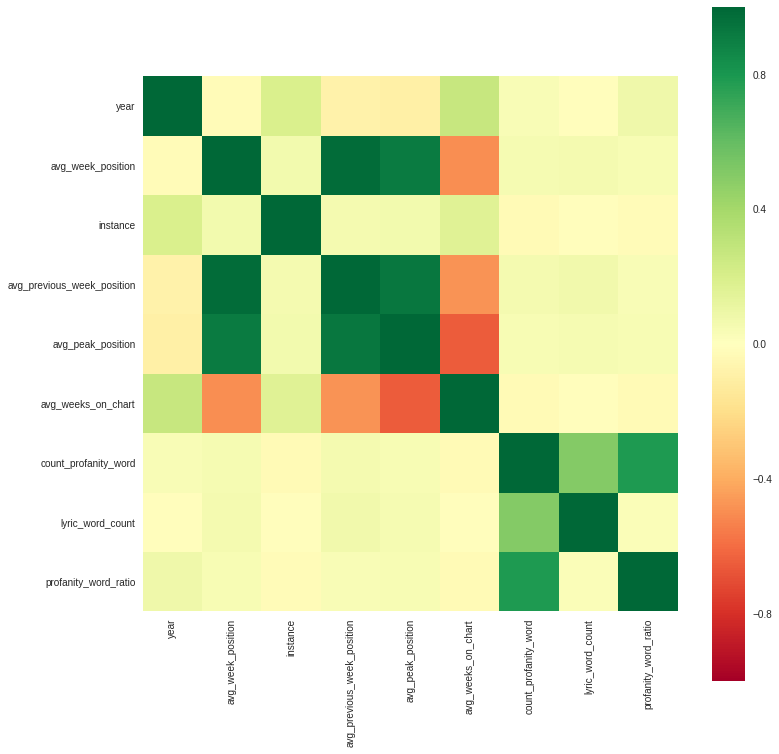

In [74]:
sns.set(rc={'figure.figsize':(12,12)})

sns.heatmap(data.corr(), square=True, cmap='RdYlGn')
#did not find correlation between count of profanity word to average rank 

### I wanted to test the linear relationship between average weekly position vs the remaining variables especially  profanicy_word_ratio. The heatmap indicates that linear regression might not be a good idea

### Therefore, clustering it is

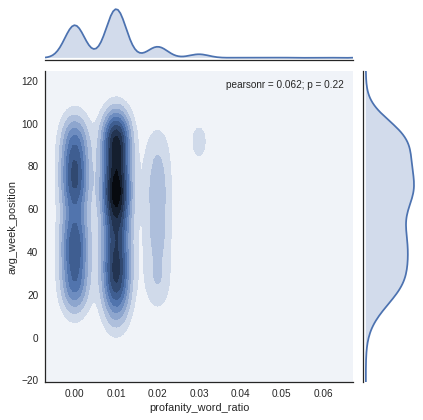

In [75]:
with sns.axes_style('white'):
    sns.jointplot("profanity_word_ratio", "avg_week_position", filtered_data, kind='kde')
#clustering might be a good direction

## Model

In [76]:
# get ready for PCA
filtered_data.head(2)

,song,year,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart,lyric,count_profanity_word,profanity_words,lyric_word_count,profanity_word_ratio
6622,Don't Let Go,1980,41.181818,1.0,35.181818,19.181818,16.0,"Let me sit this ass on you, show you how I fee...",9,ass ass ass ass damn damn hell shit shit,606,0.01
3620,Break Out,1966,66.200000,1.0,65.500000,64.800000,3.0,I am a sinner who's probably gonna sin again L...,9,bitch fuck fuckin motherfuck motherfuckin nigg...,794,0.01


In [0]:
filtered_data_with_name = filtered_data.drop(["lyric","profanity_words","year"], axis = 1).dropna()
filtered_data_PCA = filtered_data_with_name.drop(["song"], axis = 1)

In [78]:
print(len(filtered_data_PCA))
filtered_data_PCA.head()

366


,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart,count_profanity_word,lyric_word_count,profanity_word_ratio
6622,41.181818,1.0,35.181818,19.181818,16.0,9,606,0.01
3620,66.200000,1.0,65.500000,64.800000,3.0,9,794,0.01
8084,36.000000,1.0,33.333333,23.280000,13.0,3,592,0.01
20379,3.428571,1.0,3.833333,3.142857,4.0,8,947,0.01
26669,93.000000,1.0,88.000000,59.000000,9.0,1,291,0.00


**Conduct** PCA to extract the first three components, and visualize the result.

In [79]:
scaler = MinMaxScaler()
filtered_data_scaler = scaler.fit_transform(filtered_data_PCA)
#print(scaler.transform(df_cluster_features))

/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:323: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.



[0.56930032 0.28470571 0.06320329 0.0441811  0.01457655 0.01156462
 0.00979887]


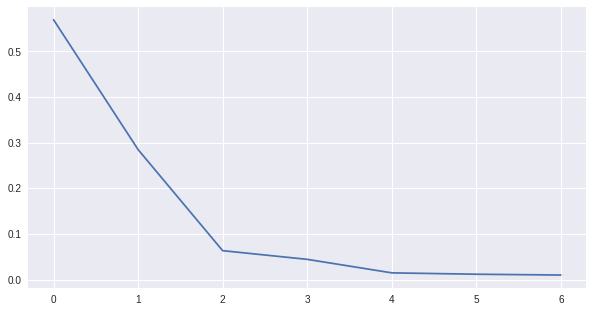

In [80]:
plt.subplots(figsize=(10,5))
pca = PCA(n_components='mle')
pca.fit(filtered_data_scaler)
plt.plot(pca.explained_variance_ratio_[:10])
print(pca.explained_variance_ratio_)

#### Three components seems ideal and just right for a 3D plot

In [81]:
components = pd.DataFrame(pca.components_[:3], columns = filtered_data_PCA.columns)
component_1 = components.iloc[0,:]
component_1[abs(component_1)>0.3]

avg_week_position            -0.541210
avg_previous_week_position   -0.559118
avg_peak_position            -0.591632
Name: 0, dtype: float64

In [82]:
component_2 = components.iloc[1,:]
component_2[abs(component_2)>0.3]

count_profanity_word    0.85938
profanity_word_ratio    0.49368
Name: 1, dtype: float64

In [83]:
component_3 = components.iloc[2,:]
component_3[abs(component_3)>0.5]

lyric_word_count        0.605814
profanity_word_ratio   -0.696776
Name: 2, dtype: float64

### Interpretation of the three components: 
#### Component1: positions 
#### Component2: profanity_count 
#### Component1: lyric_word_count 

In [84]:
# transform the original user feature df to PCA df
data_3d = pd.DataFrame(pca.transform(filtered_data_scaler)).iloc[:,:3]
data_3d.index = filtered_data_PCA.index
data_3d.rename({0:'positions',1:'profanity_count',2:'lyric_word_count'},axis=1,inplace=True)
data_3d.head()

,positions,profanity_count,lyric_word_count
6622,0.441679,0.328878,0.133634
3620,-0.202903,0.392391,0.153882
8084,0.397313,-0.101457,-0.052359
20379,0.874121,0.226372,0.080555
26669,-0.493006,-0.301679,0.075442


#### Yellowbrick Visualizer Elbow Method

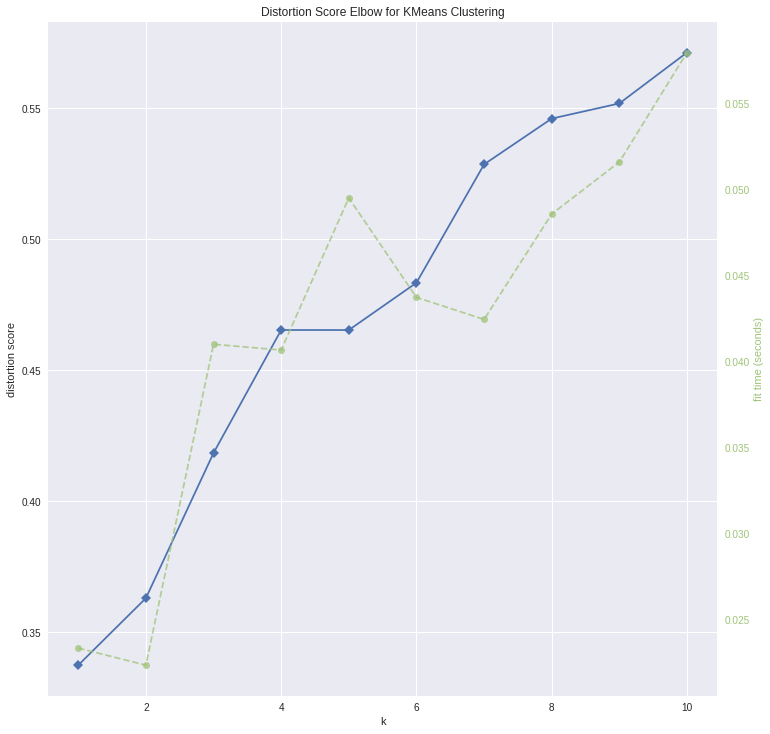

In [85]:

# from sklearn.cluster import KMeans
# from yellowbrick.cluster import KElbowVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(data_3d)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

#3 might be ok

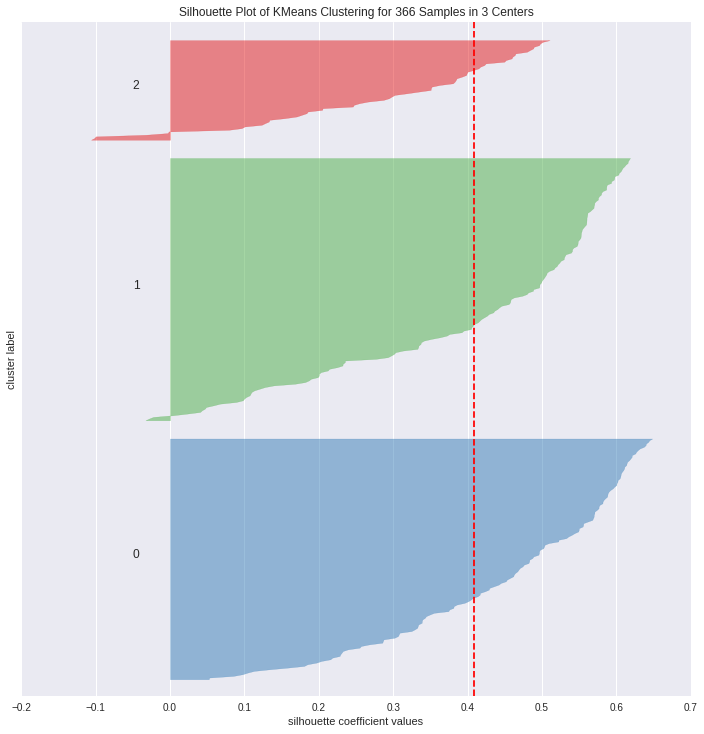

In [86]:
# from yellowbrick.cluster import SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans(3)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(data_3d) # Fit the training data to the visualizer
visualizer.poof() # Draw/show/poof the data

#4 cluster is acceptable

### Add Cluster Labels


In [87]:
#cluster using kmean with PCA components 
k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(data_3d)

#assign cluster value to data_3d for visualization
data_3d['cluster'] = kmeans.labels_
data_3d.head()

#assign cluster value back to dataset
filtered_data_PCA['cluster'] = kmeans.labels_
filtered_data_PCA.head()

,avg_week_position,instance,avg_previous_week_position,avg_peak_position,avg_weeks_on_chart,count_profanity_word,lyric_word_count,profanity_word_ratio,cluster
6622,41.181818,1.0,35.181818,19.181818,16.0,9,606,0.01,1
3620,66.200000,1.0,65.500000,64.800000,3.0,9,794,0.01,0
8084,36.000000,1.0,33.333333,23.280000,13.0,3,592,0.01,2
20379,3.428571,1.0,3.833333,3.142857,4.0,8,947,0.01,1
26669,93.000000,1.0,88.000000,59.000000,9.0,1,291,0.00,0


### Visualize the clusters

In [0]:
data_3d['song'] = filtered_data_with_name['song']

In [97]:
enable_plotly_in_cell()

trace1 = go.Scatter3d(
    x=data_3d["positions"],
    y=data_3d["profanity_count"],
    z=data_3d["lyric_word_count"],
    text=data_3d["song"],
    mode='markers',
    marker=dict(
        size=12,
        color=data_3d["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)

data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Profanity in Lyrics",
    scene = dict(
        xaxis = dict(title='X: positions'),
        yaxis = dict(title="Y: profanity_count"),
        zaxis = dict(title="Z: lyric_word_count"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

## Conclusion

### Modeling

EDA shows some distribution of the profanity words in lyrics among top 100 US Billboard songs. With visualization tools like word cloud, we will be able to visualize those most used profanity words. 

PCA is very helpful to identify those highly correlated variables to shrink the number of variables in machine learning model while keeping as much as information as possible.

Clustering methods like K-means can be useful to cluster 


### Business

Understanding lyrics and profanity words used in the profanity can be helful when recommanding songs to customers. Companies such as Spotify, iTunes will find this helpful to craft the user experience after understanding users preference on lyrics preferences. 

Also, over time there are more profanity words occurred in the lyrics and teenagers are beening exposed under this music environment. Worth introspecting.